In [1]:
import nemlig
nemlig.api.login("REDACTED_EMAIL", "REDACTED_PASSWORD")

{'RedirectUrl': '/',
 'MergeSuccessful': True,
 'ZipCodeDiffers': False,
 'TimeslotUtc': '2024101314-60-240',
 'DeliveryZoneId': 1,
 'GdprSettings': {'NewslettersIntegrationId': 0,
  'RecipesIntegrationId': 0,
  'SmsNotificationsIntegrationId': 0,
  'NemligAdsOnSearchEnginesIntegrationId': 6451139,
  'NemligAdsOnOtherSitesIntegrationId': 6451140,
  'SurveysIntegrationId': 0},
 'IsExternalLogin': False,
 'IsFirstLogin': False,
 'SaveExistingBasket': False,
 'RemovedMealBoxes': []}

In [5]:
import panel as pn
pn.extension()


In [26]:
def search_result_as_markdown(product):
    """
    Converts the results from a search into "cards" with info about each result
    and an image of the product.

    Args:
        results (dict): A dictionary containing the search results.

    Returns:
        str: A markdown representation of the search results.

    Example:
        search_results_as_markdown({
            'Products': {
                'Products': [
                    {
                        'TemplateName': 'productlistitem',
                        'PrimaryImage': 'https://www.nemlig.com/scommerce/images/agurk-oeko.jpg?i=h0XZ3ZP4/106593',
                        'Availability': {
                            'IsDeliveryAvailable': True,
                            'IsAvailableInStock': True,
                            'ReasonMessageKeys': []
                        },
                        'Id': '106593',
                        'Name': 'Agurk øko.',
                        'Category': 'Grønt',
                        'SubCategory': 'Agurk / Tomat',
                        'Url': 'agurk-oeko-106593',
                        'UnitPrice': '10,00 kr./Stk.',
                        'UnitPriceCalc': 10.0,
                        'UnitPriceLabel': 'kr./Stk.',
                        'DiscountItem': True,
                        'Description': '1 stk. / Spanien / Klasse 1',
                        'SaleBeforeLastSalesDate': 0,
                        'Price': 10.0,
                        'Campaign': None,
                        'Labels': ['Øko (europæisk)', 'Discount'],
                        'Favorite': True,
                        'ProductSubGroupNumber': '6200100007',
                        'ProductSubGroupName': 'Agurk',
                        'ProductCategoryGroupNumber': '6200100000',
                        'ProductCategoryGroupName': 'Grønt',
                        'ProductMainGroupNumber': '6200000000',
                        'ProductMainGroupName': 'Frugt og grønt'
                    }
                ]
            }
        })

    Returns:
        [![Agurk øko.](https://www.nemlig.com/scommerce/images/agurk-oeko.jpg?i=h0XZ3ZP4/106593)](https://www.nemlig.com/agurk-oeko-106593)
        
        **Name:** Agurk øko.
        **Unit Price:** 10,00 kr./Stk.
        **Description:** 1 stk. / Spanien / Klasse 1
        """


    
    return f"""
<div class='card' style='width: 18rem;'>
  <div class='card-body'>
    <h3 class='card-title'>{product['Name']}</h3>
    <img src='{product['PrimaryImage']}' class='card-img-top' style='width: 120px;'>
    <h5 class='card-text'>Unit Price:</h5>
    <p class='card-text'>{product['UnitPrice']}</p>
    <p class='card-text'>{product['Description']}</p>
  </div>
</div>"""

#results = nemlig.api.search_products("agurk")
products = results['Products']['Products']

html_and_id = map(lambda product: (search_result_as_markdown(product), product["Id"]) , products)

layouts = []
to_buy = {"ids":[]}
callbacks = {}
for html, _id in html_and_id:
    pane = pn.pane.HTML(html, width=200)

    def on_button_click(event, _id=_id):
        print(f"Product ID: {_id}")
        to_buy["ids"].append(_id)

    callbacks[_id] = on_button_click
    # Create a Button widget
    button = pn.widgets.Button(name='Press Me', button_type='primary')
    button.on_click(callbacks[_id])
    layouts.append(pn.Column(pane, button))

pn.FlexBox(*layouts)


FlexBox(objects=[Column
    [0] HTML(str, ...], sizing_mode='stretch_width')

In [28]:
to_buy

{'ids': []}

In [ ]:
results_html = []
for res in search_results_as_markdown(results):
    results_html.append(pn.pane.HTML(res, width=200))

    # Define a callback function that will be triggered on button press
    def on_button_click(event):
        print("Button pressed!")
    
    # Create a Button widget
    button = pn.widgets.Button(name='Press Me', button_type='primary')
    
    # Attach the callback to the button's 'on_click' event
    button.on_click(on_button_click)
    
    # Create a Pane to display a message or content
    pane = pn.pane.Markdown("Press the button to trigger a function.")
    
    # Display both the Pane and Button
    layout = pn.Column(pane, button)


box = pn.FlexBox(*results_html)
box

In [5]:
import requests
from PIL import Image
import requests
from io import BytesIO
import pandas as pd
from IPython.display import display, HTML
import panel as pn
pn.extension()

# https://github.com/schourode/nemlig

nemlig_base = "https://www.nemlig.com/webapi"
nemlig_search = nemlig_base + "/s/0/1/0/Search/Search"


def url_to_img(url):
    """
    # URL of the image
    url = 'https://live.nemligstatic.com/scommerce/images/kartofler-oeko.jpg?i=bk0-rjYI/5053960'

    """
    # Open the url image, set stream to True, this will return the stream content.
    response = requests.get(url, stream=True)

    # Open a stream to the image
    return Image.open(response.raw)


In [6]:
import nemlig

In [13]:
products_list = search("kartofler")


In [18]:
products_list

NameError: name 'products_list' is not defined

In [16]:
# Create a Pane to display a message or content
pane = pn.pane.HTML("<button id='my-button'>Click Me!</button>", height=100)



# Define a JavaScript function to trigger when the pane loads
# This function adds an alert when the button is clicked
js_code = """
var btn = document.getElementById('my-button');
btn.addEventListener('click', function() {
    alert('Button clicked!');
});
"""

# Use js_on_load to run the JavaScript code once the pane is loaded
pane.js_on_load(js_code)


# Display both the Pane and Button
layout = pn.Column(pane)
layout



AttributeError: 'HTML' object has no attribute 'js_on_load'

FlexBox(objects=[HTML(str, height=100, ...], sizing_mode='stretch_width')

GridBox(ncols=4, width=800)
    [0] Markdown(str)
    [1] PNG(str, height=128)
    [2] Markdown(str)
    [3] Markdown(str)
    [4] Markdown(str)
    [5] PNG(str, height=128)
    [6] Markdown(str)
    [7] Markdown(str)
    [8] Markdown(str)
    [9] PNG(str, height=128)
    [10] Markdown(str)
    [11] Markdown(str)
    [12] Markdown(str)
    [13] PNG(str, height=128)
    [14] Markdown(str)
    [15] Markdown(str)
    [16] Markdown(str)
    [17] PNG(str, height=128)
    [18] Markdown(str)
    [19] Markdown(str)
    [20] Markdown(str)
    [21] PNG(str, height=128)
    [22] Markdown(str)
    [23] Markdown(str)
    [24] Markdown(str)
    [25] PNG(str, height=128)
    [26] Markdown(str)
    [27] Markdown(str)
    [28] Markdown(str)
    [29] PNG(str, height=128)
    [30] Markdown(str)
    [31] Markdown(str)
    [32] Markdown(str)
    [33] PNG(str, height=128)
    [34] Markdown(str)
    [35] Markdown(str)
    [36] Markdown(str)
    [37] PNG(str, height=128)
    [38] Markdown(str)
    [39] Markdown(str)
    [40] Markdown(str)
    [41] PNG(str, height=128)
    [42] Markdown(str)
    [43] Markdown(str)
    [44] Markdown(str)
    [45] PNG(str, height=128)
    [46] Markdown(str)
    [47] Markdown(str)
    [48] Markdown(str)
    [49] PNG(str, height=128)
    [50] Markdown(str)
    [51] Markdown(str)
    [52] Markdown(str)
    [53] PNG(str, height=128)
    [54] Markdown(str)
    [55] Markdown(str)
    [56] Markdown(str)
    [57] PNG(str, height=128)
    [58] Markdown(str)
    [59] Markdown(str)
    [60] Markdown(str)
    [61] PNG(str, height=128)
    [62] Markdown(str)
    [63] Markdown(str)
    [64] Markdown(str)
    [65] PNG(str, height=128)
    [66] Markdown(str)
    [67] Markdown(str)
    [68] Markdown(str)
    [69] PNG(str, height=128)
    [70] Markdown(str)
    [71] Markdown(str)
    [72] Markdown(str)
    [73] PNG(str, height=128)
    [74] Markdown(str)
    [75] Markdown(str)
    [76] Markdown(str)
    [77] PNG(str, height=128)
    [78] Markdown(str)
    [79] Markdown(str)
    [80] Markdown(str)
    [81] PNG(str, height=128)
    [82] Markdown(str)
    [83] Markdown(str)
    [84] Markdown(str)
    [85] PNG(str, height=128)
    [86] Markdown(str)
    [87] Markdown(str)
    [88] Markdown(str)
    [89] PNG(str, height=128)
    [90] Markdown(str)
    [91] Markdown(str)
    [92] Markdown(str)
    [93] PNG(str, height=128)
    [94] Markdown(str)
    [95] Markdown(str)
    [96] Markdown(str)
    [97] PNG(str, height=128)
    [98] Markdown(str)
    [99] Markdown(str)
    [100] Markdown(str)
    [101] PNG(str, height=128)
    [102] Markdown(str)
    [103] Markdown(str)
    [104] Markdown(str)
    [105] PNG(str, height=128)
    [106] Markdown(str)
    [107] Markdown(str)
    [108] Markdown(str)
    [109] PNG(str, height=128)
    [110] Markdown(str)
    [111] Markdown(str)
    [112] Markdown(str)
    [113] PNG(str, height=128)
    [114] Markdown(str)
    [115] Markdown(str)
    [116] Markdown(str)
    [117] PNG(str, height=128)
    [118] Markdown(str)
    [119] Markdown(str)
    [120] Markdown(str)
    [121] PNG(str, height=128)
    [122] Markdown(str)
    [123] Markdown(str)
    [124] Markdown(str)
    [125] PNG(str, height=128)
    [126] Markdown(str)
    [127] Markdown(str)
    [128] Markdown(str)
    [129] PNG(str, height=128)
    [130] Markdown(str)
    [131] Markdown(str)
    [132] Markdown(str)
    [133] PNG(str, height=128)
    [134] Markdown(str)
    [135] Markdown(str)
    [136] Markdown(str)
    [137] PNG(str, height=128)
    [138] Markdown(str)
    [139] Markdown(str)
    [140] Markdown(str)
    [141] PNG(str, height=128)
    [142] Markdown(str)
    [143] Markdown(str)
    [144] Markdown(str)
    [145] PNG(str, height=128)
    [146] Markdown(str)
    [147] Markdown(str)
    [148] Markdown(str)
    [149] PNG(str, height=128)
    [150] Markdown(str)
    [151] Markdown(str)
    [152] Markdown(str)
    [153] PNG(str, height=128)
    [154] Markdown(str)
    [155] Markdown(str)
    [156] Markdown(str)
    [157] PNG(str, height=128)
    [158] 
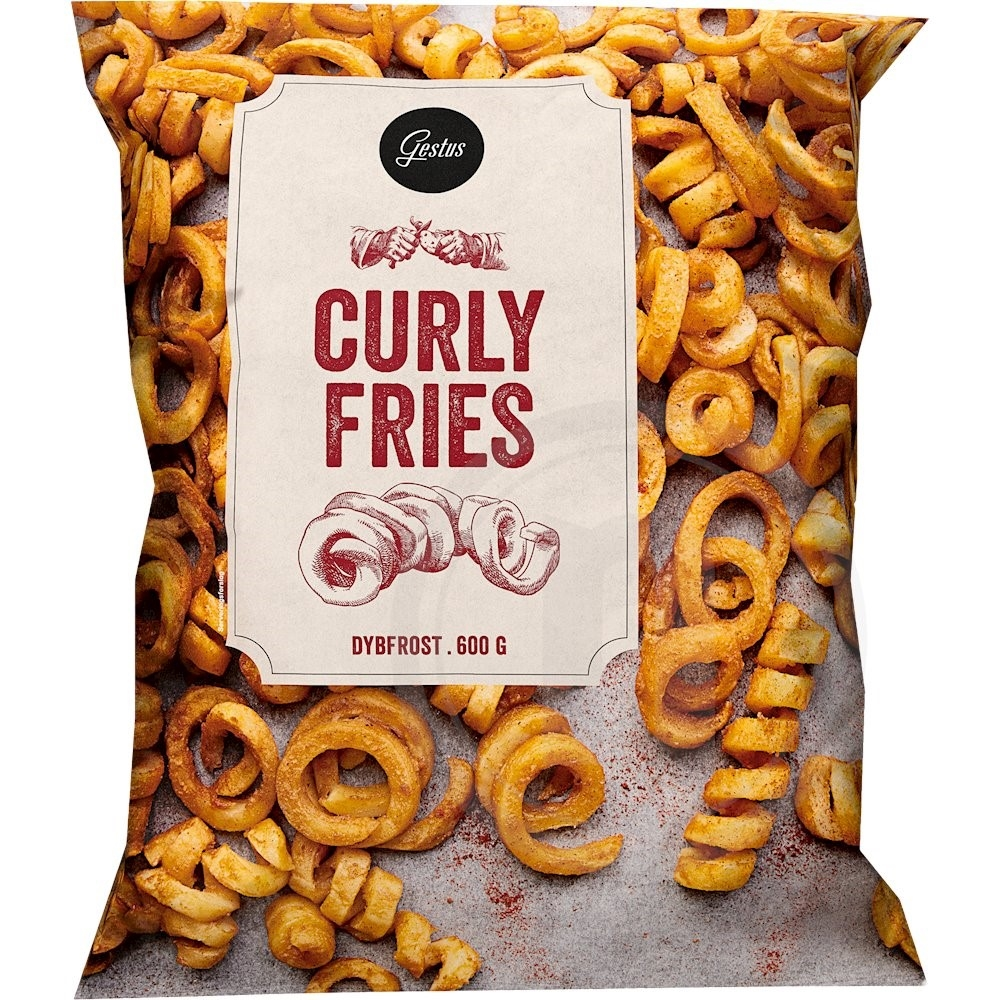
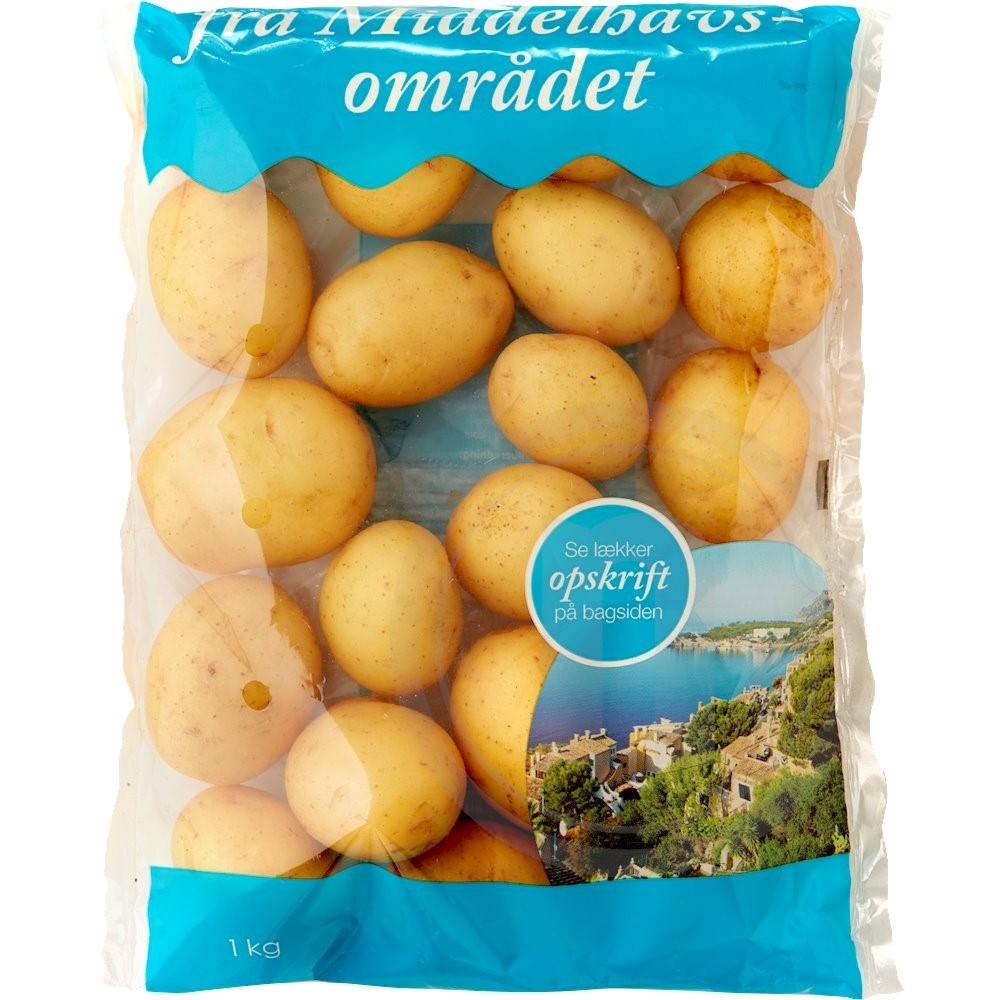
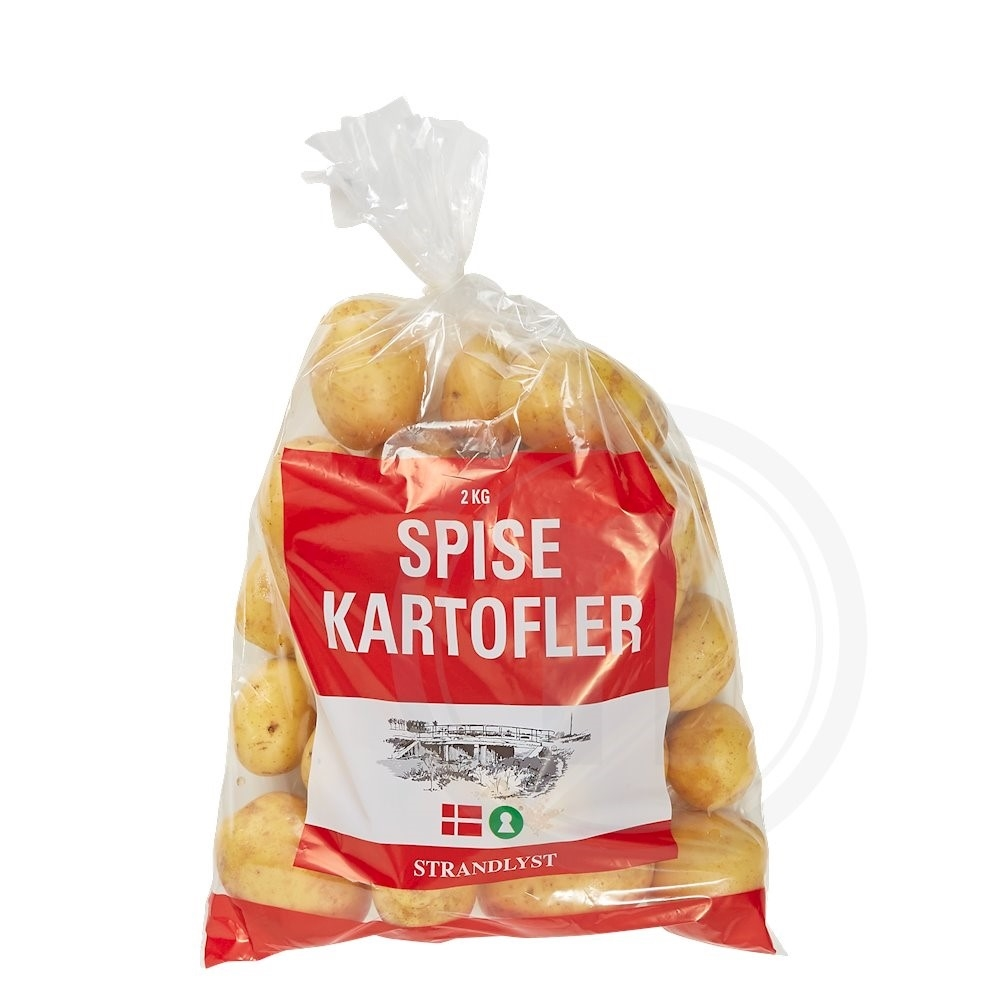
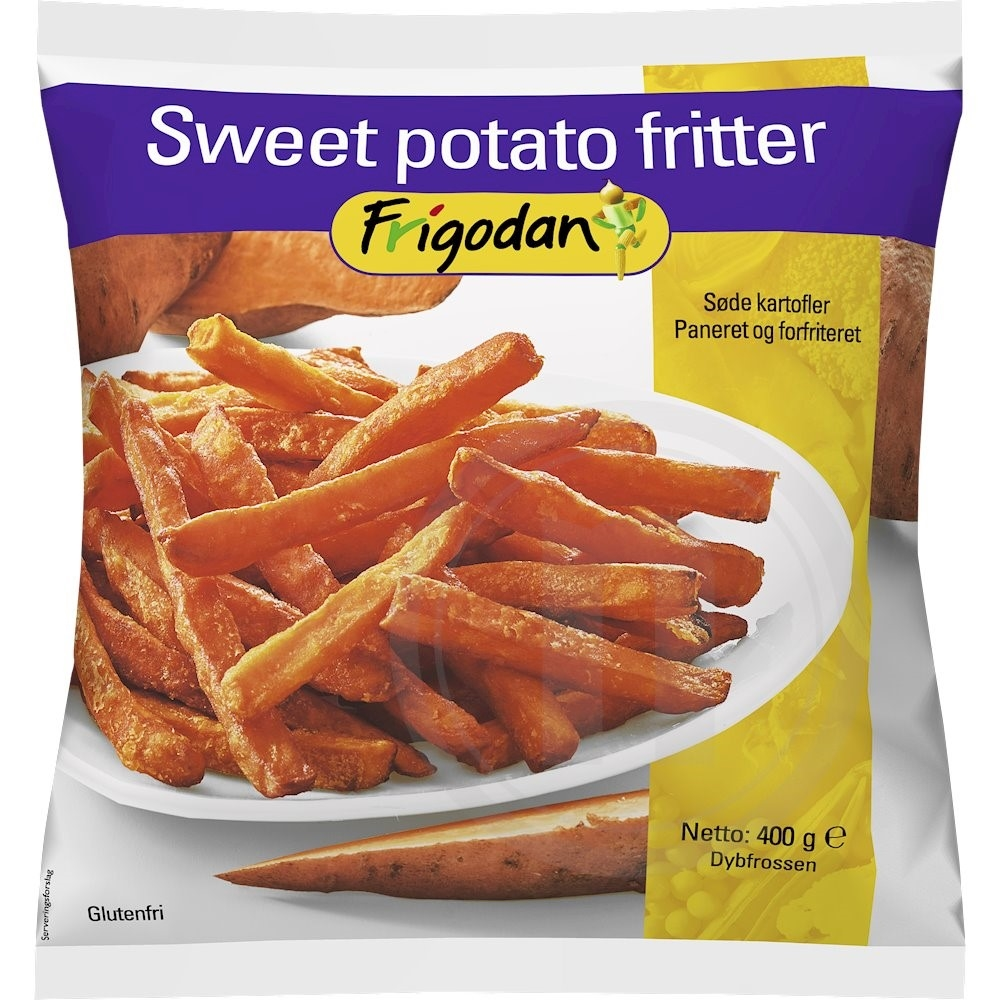
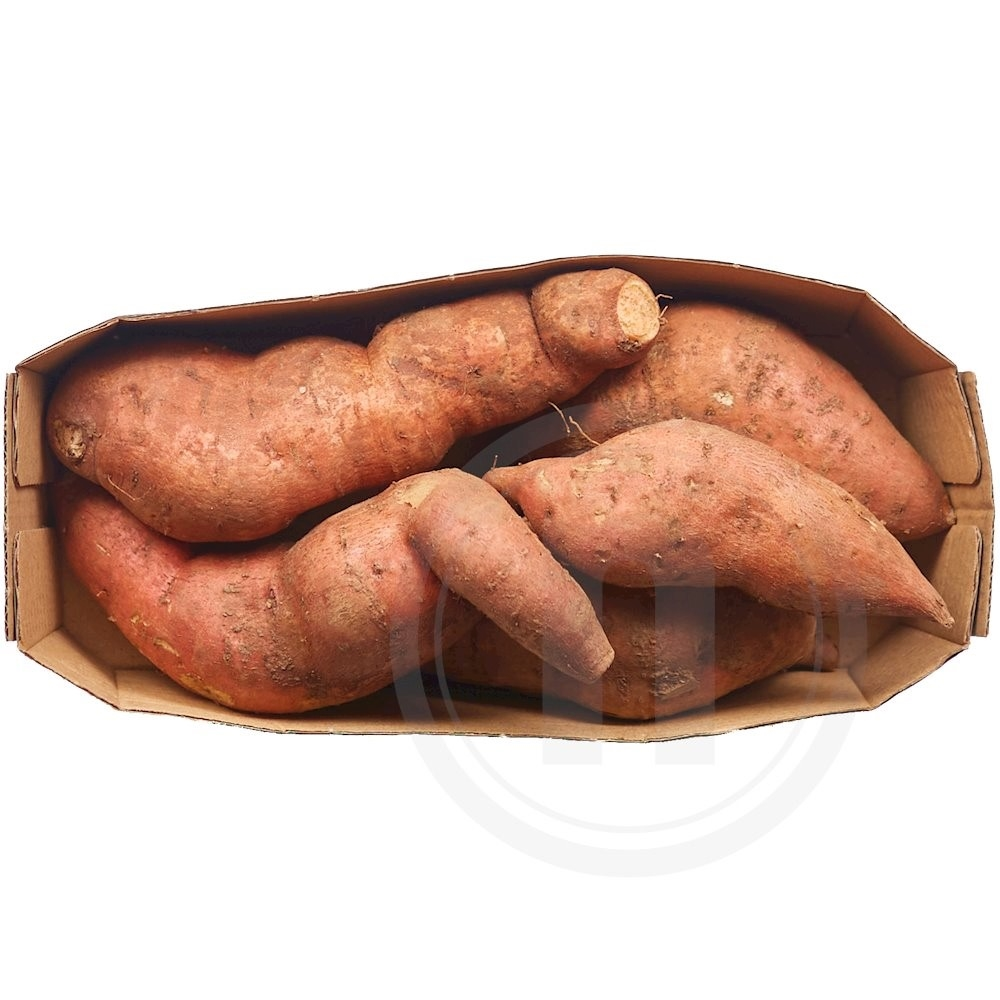
...
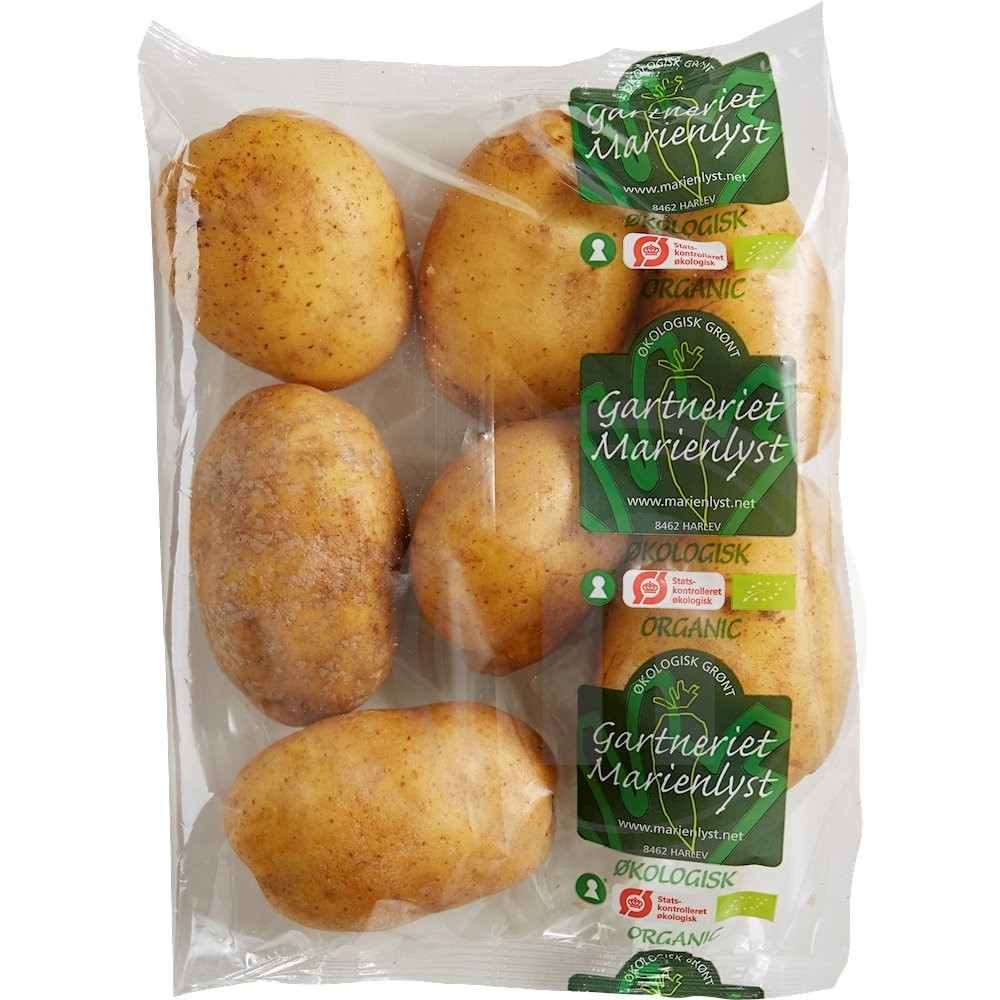
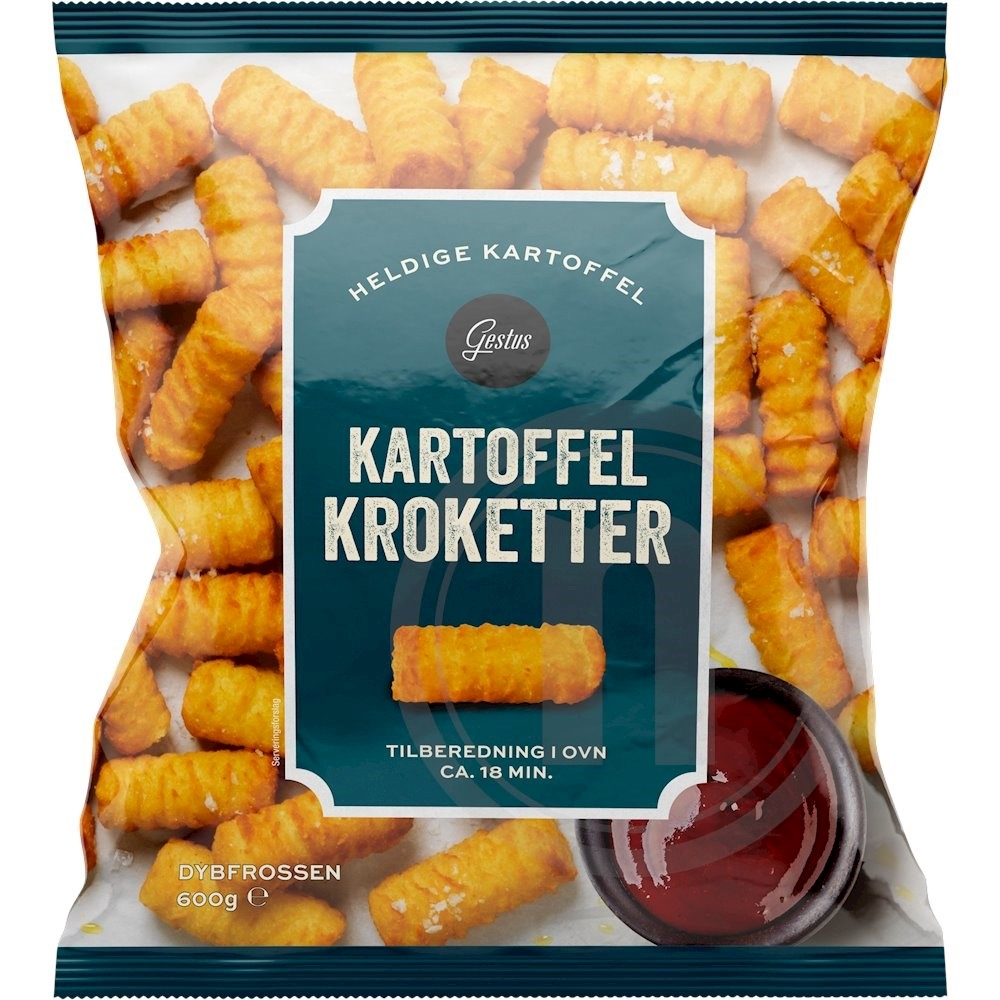
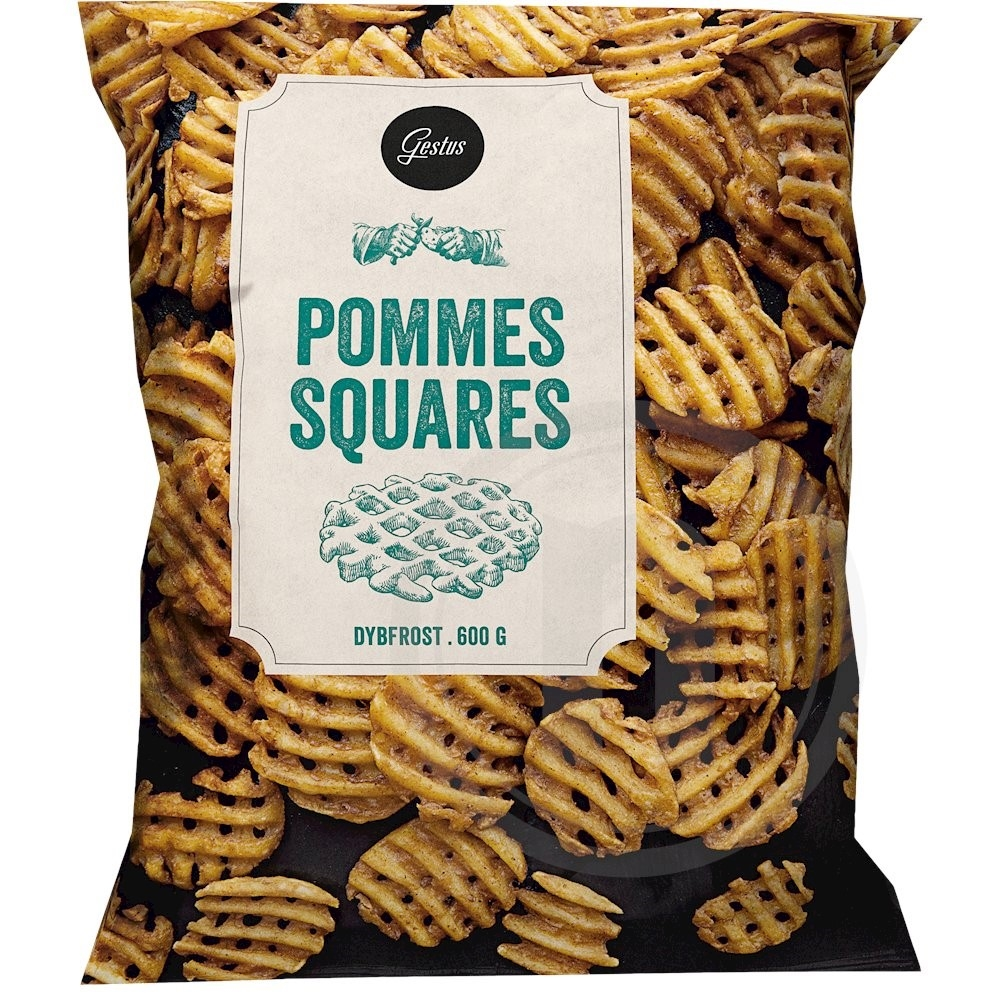
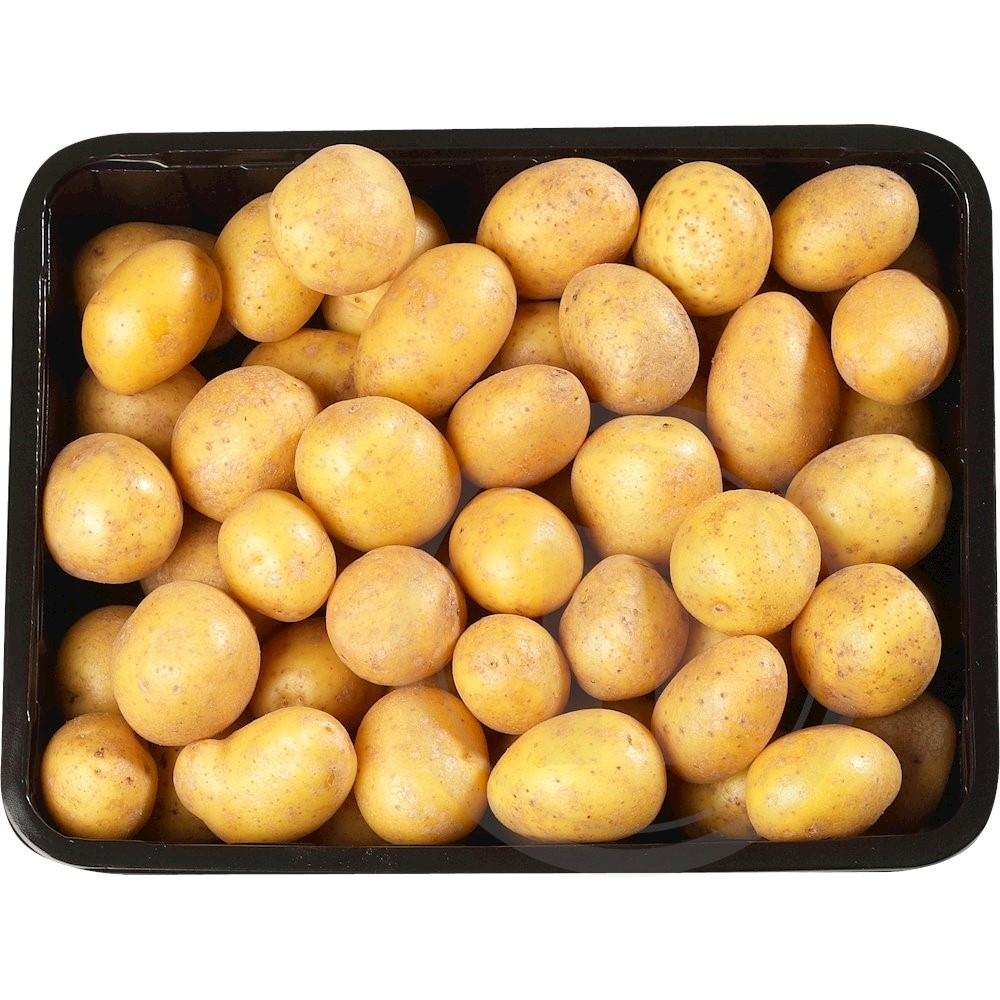
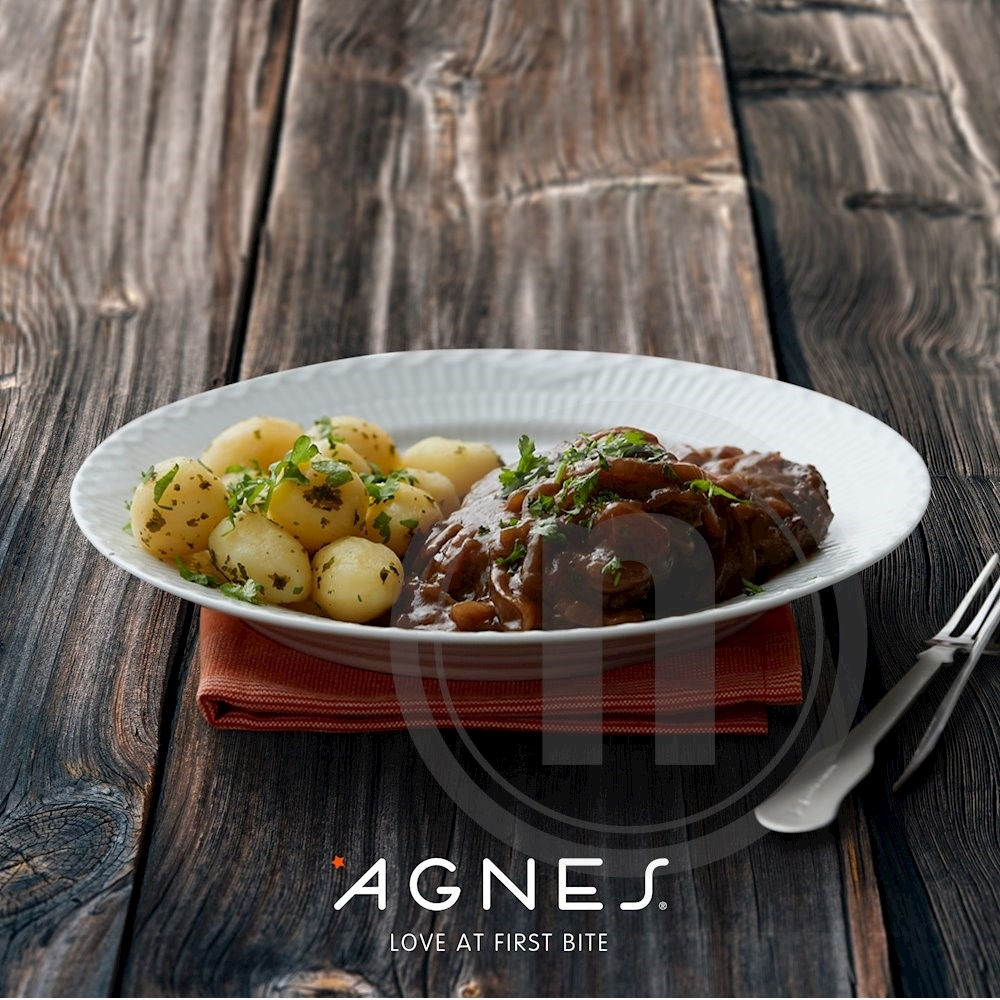

In [21]:
# Define the grid structure
grid = pn.GridBox(ncols=4, width=800)

# Iterate over the dataframe and add rows to the grid
for row in sorted(products_list, key= lambda p: p["UnitPriceCalc"]):
    image = pn.pane.PNG(row['PrimaryImage'], height=128)  # Create an image pane
    grid.extend(
        (
            f"{row.get('Brand'], '')} {row['Name']}",
            image,
            f"{row['Price']} kr ({row['UnitPriceCalc']} {row['UnitPriceLabel']})",
            row['Description']
        )
    )

grid.servable()

In [18]:
# Define the grid structure
grid = pn.GridBox(ncols=4, width=800)

# Iterate over the dataframe and add rows to the grid
for row in sorted(products_list, key= lambda p: p["UnitPriceCalc"]):
    image = pn.pane.PNG(row['PrimaryImage'], height=128)  # Create an image pane
    grid.extend(
        (
            f"{row.get('Brand', '')} {row['Name']}",
            image,
            f"{row['Price']} kr ({row['UnitPriceCalc']} {row['UnitPriceLabel']})",
            row['Description']
        )
    )

grid.servable()

{'TemplateName': 'productlistitem',
 'PrimaryImage': 'https://www.nemlig.com/scommerce/images/bagekartoffel.jpg?i=u3bQ8dYR/5044361',
 'Availability': {'IsDeliveryAvailable': True,
  'IsAvailableInStock': True,
  'ReasonMessageKeys': []},
 'CampaignAttribute': 'Fast mixtilbud',
 'Id': '5044361',
 'Name': 'Bagekartoffel',
 'Category': 'Grønt',
 'SubCategory': 'Kartofler',
 'Url': 'bagekartoffel-5044361',
 'UnitPrice': None,
 'UnitPriceCalc': 6.0,
 'UnitPriceLabel': 'kr./Stk.',
 'DiscountItem': False,
 'Description': '1 stk. / Melody / Danmark / Klasse 1',
 'SaleBeforeLastSalesDate': 0,
 'Price': 6.0,
 'Campaign': {'MinQuantity': 4,
  'MaxQuantity': 0,
  'TotalPrice': 20.0,
  'CampaignPrice': 20.0,
  'CampaignUnitPrice': None,
  'Type': 'ProductCampaignBuyXForY',
  'Code': 'KF',
  'DiscountSavings': 0.0,
  'IntervalStart': '2023-01-11T23:00:00Z',
  'IntervalEnd': '2024-12-31T22:59:59Z',
  'ShowCampaignInterval': False},
 'Labels': ['Produceret i Danmark'],
 'Favorite': False,
 'ProductSub